<a href="https://colab.research.google.com/github/cnewmyer/visualization/blob/main/WaterProj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import keras
import numpy as np
import pickle

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.callbacks import EarlyStopping

from google.colab import drive
drive.mount('/drive/')

!pip install nbconvert

import os
import nbconvert

# Convert the notebook to PDF
notebook_file = '/drive/MyDrive/WaterProj.ipynb'  # Replace with the path to your notebook
pdf_output_file = '/drive/MyDrive/WaterProj.pdf'  # Replace with your desired output PDF file path

pdf_exporter = nbconvert.PDFExporter()
pdf_data, _ = pdf_exporter.from_filename(notebook_file)

with open(pdf_output_file, 'wb') as f:
    f.write(pdf_data)

Drive already mounted at /drive/; to attempt to forcibly remount, call drive.mount("/drive/", force_remount=True).
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


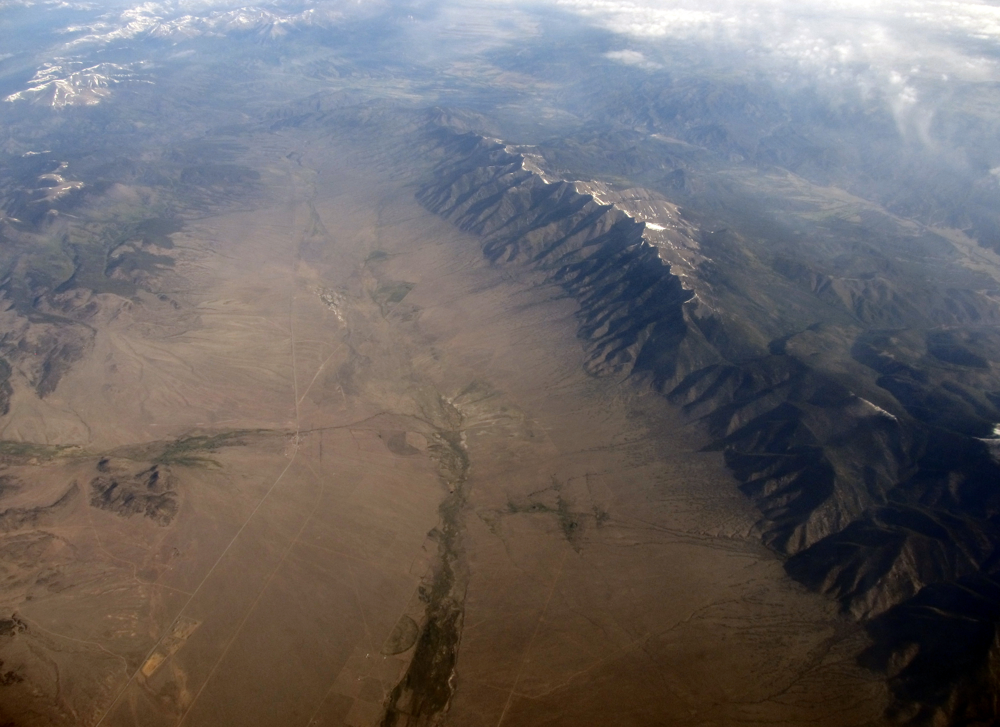

In [12]:
from PIL import Image

image_path2 = '/content/Northern_End_of_San_Luis_Valley,_Colorado_(7235128470).jpg'  # Replace 'image.jpg' with the actual filename and extension
image2 = Image.open(image_path2)

# Display the image
image2.show()

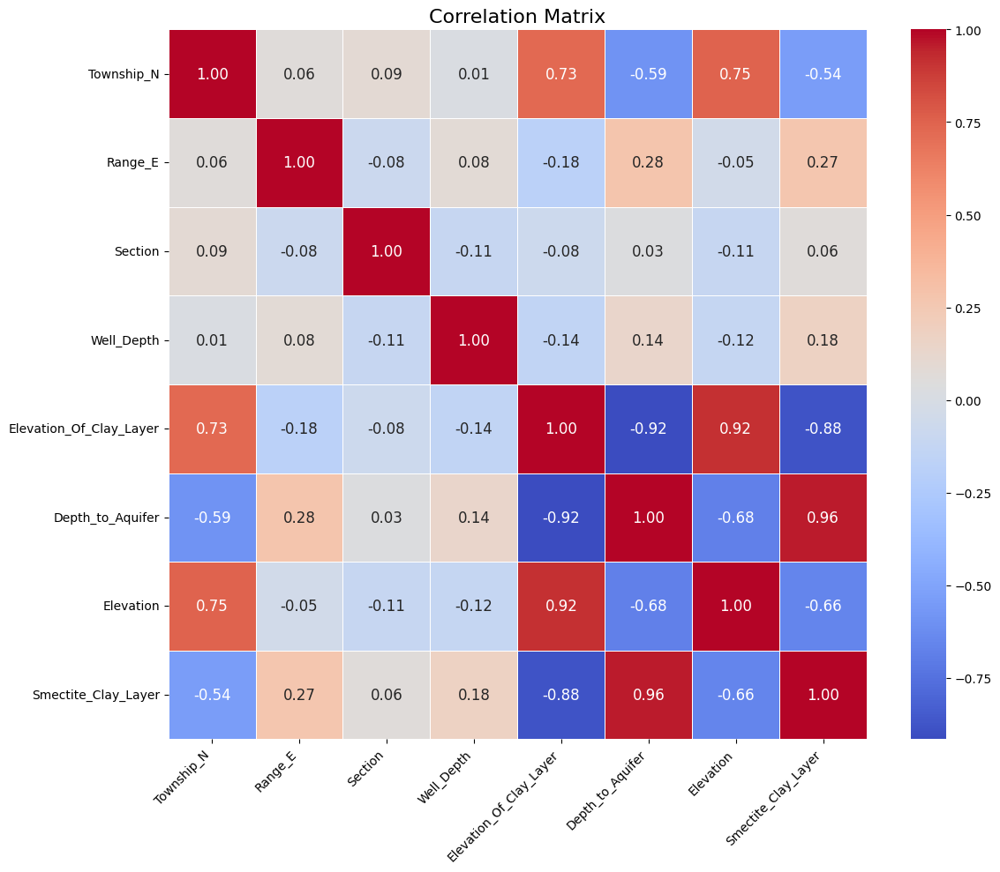

Epoch 1/500
18/18 [==============================] - 6s 46ms/step - loss: 0.4867 - accuracy: 0.8960 - val_loss: 0.2797 - val_accuracy: 0.9836
Epoch 2/500
18/18 [==============================] - 0s 18ms/step - loss: 0.1844 - accuracy: 0.9818 - val_loss: 0.1084 - val_accuracy: 0.9836
Epoch 3/500
18/18 [==============================] - 0s 15ms/step - loss: 0.0790 - accuracy: 0.9945 - val_loss: 0.0546 - val_accuracy: 1.0000
Epoch 4/500
18/18 [==============================] - 0s 20ms/step - loss: 0.0425 - accuracy: 0.9982 - val_loss: 0.0314 - val_accuracy: 1.0000
Epoch 5/500
18/18 [==============================] - 0s 9ms/step - loss: 0.0280 - accuracy: 0.9982 - val_loss: 0.0208 - val_accuracy: 1.0000
Epoch 6/500
18/18 [==============================] - 0s 10ms/step - loss: 0.0213 - accuracy: 0.9982 - val_loss: 0.0149 - val_accuracy: 1.0000
Epoch 7/500
18/18 [==============================] - 0s 17ms/step - loss: 0.0175 - accuracy: 0.9982 - val_loss: 0.0098 - val_accuracy: 1.0000
Epoch 8

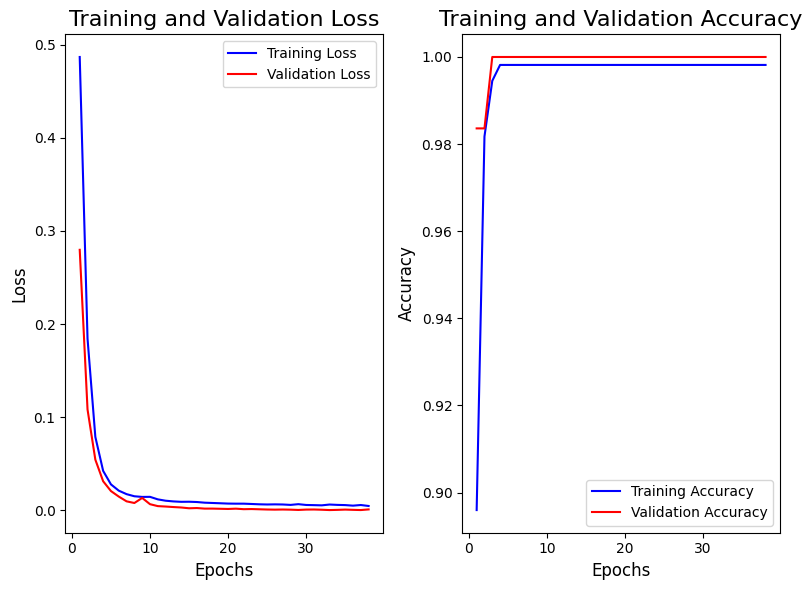

2/2 [==============================] - 0s 6ms/step


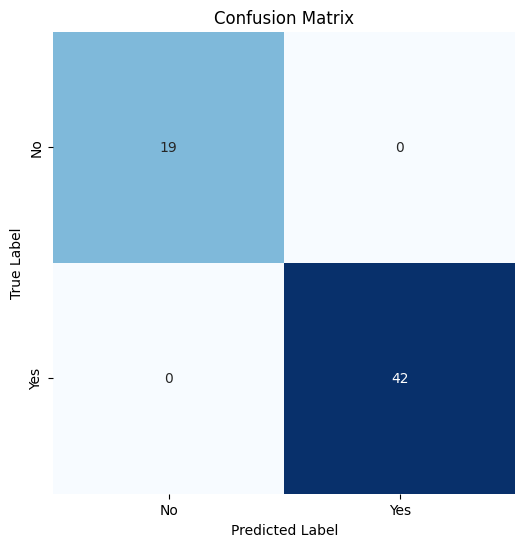

7/7 [==============================] - 0s 3ms/step
Predictions with Elevation for Predicted Label 1:
     Elevation of Clay Layer  Predicted Label
247                     7575                1
589                     7600                1
227                     7585                1
291                     7590                1
539                     7620                1
..                       ...              ...
265                     7570                1
302                     7565                1
90                      7545                1
335                     7555                1
181                     7635                1

[135 rows x 2 columns]
Elevation for Predicted Label 0:
799    7700
445    7665
423    7630
453    7675
809    7700
       ... 
383    7640
381    7640
447    7685
375    7640
789    7800
Name: Elevation of Clay Layer, Length: 69, dtype: int64


In [13]:
# Read the data
data = pd.read_csv('/content/WaterProjDataB.csv')

# Define the desired order of features
feature_order = ['Township_N', 'Range_E', 'Section', 'Well_Depth', 'Elevation_Of_Clay_Layer', 'Depth_to_Aquifer', 'Elevation']

# Reorder the columns of the data DataFrame based on the desired feature order
data2 = data[feature_order + ['Smectite_Clay_Layer']]

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(12, 10))

# Create a heatmap of the correlation matrix with the desired feature order
correlation_matrix = data2.corr()
correlation_matrix = correlation_matrix[feature_order + ['Smectite_Clay_Layer']]

# Customize the heatmap
heatmap = sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5, annot_kws={"fontsize": 12}, ax=ax)

# Rotate and align the horizontal axis labels
heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, ha='right')
heatmap.set_yticklabels(heatmap.get_yticklabels(), rotation=0, ha='right')

# Set the plot title and labels
ax.set_title('Correlation Matrix', fontsize=16)

# Show the plot
plt.tight_layout()
plt.show()

# Separate the features (inputs) and target variable (output)
features = data[feature_order]
target = data['Smectite_Clay_Layer']

# Split the data into train, test, and validation sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.10, random_state=42)

# Perform any necessary preprocessing
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

# Build the deep learning model
model = Sequential()
model.add(Dense(128, activation='relu', input_shape=(X_train_scaled.shape[1],)))
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define Early Stopping callback
early_stopping = EarlyStopping(patience=5, monitor='val_loss')

# Train the model with Early Stopping
history = model.fit(X_train_scaled, y_train, epochs=500, batch_size=32, validation_data=(X_val_scaled, y_val), callbacks=[early_stopping], verbose = 1)

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(X_test_scaled, y_test)
print('Test Loss:', test_loss)
print('Test Accuracy:', test_accuracy)

# Calculate test accuracy as a percentage
test_accuracy_percentage = test_accuracy * 100
print('Test Accuracy (Percentage): {:.2f}%'.format(test_accuracy_percentage))

# Make predictions
predictions = model.predict(X_test_scaled)
predicted_labels = [1 if pred > 0.5 else 0 for pred in predictions]

# Plot the training and validation accuracy
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
epochs = range(1, len(train_accuracy) + 1)

# Create the figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 6))

# Plot training and validation loss
train_loss = history.history['loss']
val_loss = history.history['val_loss']
ax1.plot(epochs, train_loss, 'b', label='Training Loss')
ax1.plot(epochs, val_loss, 'r', label='Validation Loss')
ax1.set_title('Training and Validation Loss', fontsize=16)
ax1.set_xlabel('Epochs', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.legend()

# Plot training and validation accuracy
ax2.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
ax2.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')
ax2.set_title('Training and Validation Accuracy', fontsize=16)
ax2.set_xlabel('Epochs', fontsize=12)
ax2.set_ylabel('Accuracy', fontsize=12)
ax2.legend()

plt.tight_layout()
plt.show()

# Generate predictions on the validation set
validation_predictions = model.predict(X_val_scaled)
predicted_labels = [1 if pred > 0.5 else 0 for pred in validation_predictions]

# Compute the confusion matrix
confusion = confusion_matrix(y_val, predicted_labels)

# Create a figure and axes
fig, ax = plt.subplots(figsize=(8, 6))

# Customize the heatmap
sns.heatmap(confusion, annot=True, cmap='Blues', fmt='d', cbar=False, square=True,
            xticklabels=['No', 'Yes'], yticklabels=['No', 'Yes'], ax=ax)

# Add labels and title
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
ax.set_title('Confusion Matrix')

# Show the plot
plt.show()

# Make predictions
predictions = model.predict(X_test_scaled)
predicted_labels = [1 if pred > 0.5 else 0 for pred in predictions]

# Create a DataFrame with elevation and predictions
elevation_predictions = pd.DataFrame({'Elevation of Clay Layer': X_test['Elevation'], 'Predicted Label': predicted_labels})

# Filter the DataFrame based on predictions
predictions_1 = elevation_predictions[elevation_predictions['Predicted Label'] == 1]
predictions_0 = elevation_predictions[elevation_predictions['Predicted Label'] == 0]

# Display the tables
if not predictions_1.empty:
    print("Predictions with Elevation for Predicted Label 1:")
    print(predictions_1)
else:
    print("No Predictions with Elevation for Predicted Label 1")

if not predictions_0.empty:
    print("Elevation for Predicted Label 0:")
    print(predictions_0['Elevation of Clay Layer'])
else:
    print("No Elevation for Predicted Label 0")

# Save the model to a file
with open('model.pkl', 'wb') as file:
    pickle.dump(model, file)

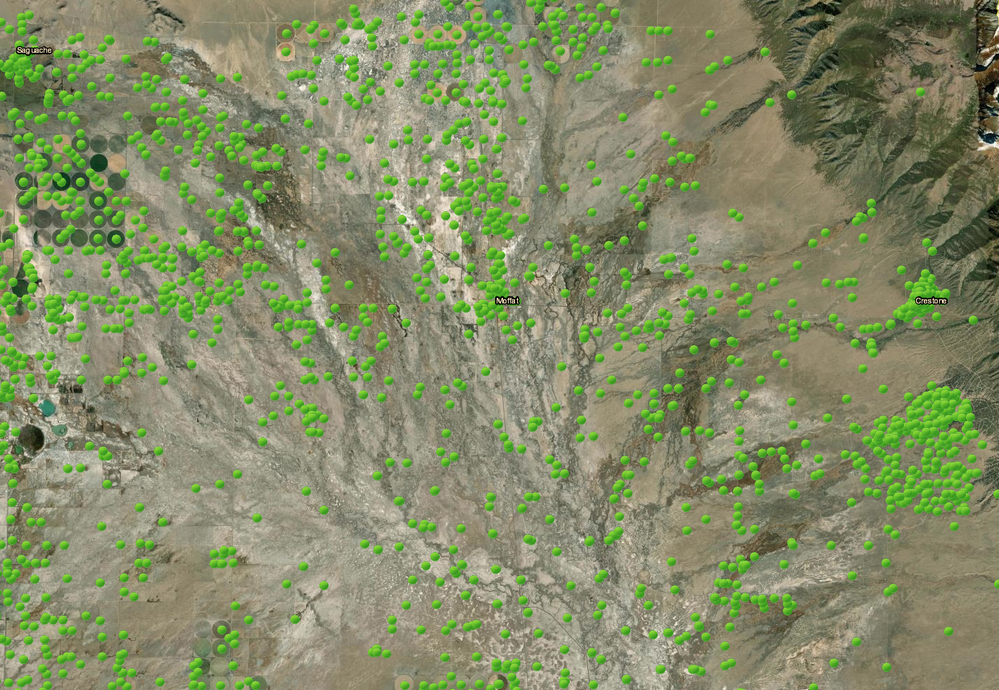

In [14]:
image_path = '/content/Wells.png'  # Replace 'image.jpg' with the actual filename and extension
image = Image.open(image_path)

# Display the image
image.show()

In [15]:
# Prompt the user to enter section, township, and range values
township = int(input("Enter the township: "))
range_value = int(input("Enter the range: "))
section = int(input("Enter the section: "))

# Filter the data based on user input
indices = (data['Township_N'] == township) & (data['Range_E'] == range_value) & (data['Section'] == section)
user_data = data.loc[indices]

if len(user_data) > 0:
    # Remove the unnecessary column from user data
    user_data = user_data.drop(columns=['Smectite_Clay_Layer'])

    # Scale the user input using the same scaler used for training data
    user_data_scaled = scaler.transform(user_data)

    # Make predictions on the user input
    predictions = model.predict(user_data_scaled)
    predicted_label = [1 if pred > 0.5 else 0 for pred in predictions]

    if predicted_label[0] == 1:
        # Get the corresponding elevation of the clay layer from the original dataset
        elevation_of_clay_layer = data.loc[indices, 'Elevation_Of_Clay_Layer']

        if len(elevation_of_clay_layer) > 1:
            # Calculate the average elevation
            average_elevation = elevation_of_clay_layer.mean()

            # Display the average elevation of the clay layer
            print("Smectite clay layer likely at elevation:", average_elevation, "ft.")
        else:
            # Display the elevation of the clay layer
            print("Smectite clay layer likely at elevation:", elevation_of_clay_layer.item(), "ft.")
    else:
        print("No smectite clay layer predicted.")
else:
    print("No matching data found for the given township, range, and section.")

Enter the township: 42
Enter the range: 8
Enter the section: 36
1/1 [==============================] - 0s 23ms/step
Smectite clay layer likely at elevation: 7435 ft.
